# Proyecto Métodos Numéricos 2025-B

## Proyecto Blackbox *S*

La red neuronal **Blackbox *S*** es una función paramétrica $f_\theta:\mathbb{R}^2 \rightarrow \mathbb{B}; (x_1, x_2) \mapsto f(x_1, x_2) \forall x_1 \ge 0$.


Esto nos quiere decir que la red neuronal toma un vector que pertenece al espacio $\in \mathbb{R}^2$ y nos devuelve un valor de 0 $\lor$ 1 que pertenece al espacio de $\in \mathbb{B}$

El modelo de la red neuronal esta guardada en el archivo `blackbox_S.keras` y es cargada con `Blackbox/blackbox.py` el cual cuenta con las siguientes funciones:

In [2]:
from Blackbox import load_model, predict_point, predict_batch

De las cuales load model es utilizada para cargar el modelo de keras, predict point para predecir un punto dado un vector, y predict batch para predecir una lista de vectores 

Para poder utilizar estas funciones es necesario instalar las librerias definidas en `requirements.txt` adicionalmente la libreria de tensorflow en una version compatible con la version de keras instalada (3.9.2)

### Paso 1: Importar las librerias y cargar el modelo

In [3]:
from Blackbox import load_model
model = load_model()


Current working directory: /home/daxrpm/Desktop/EPN/metodos_numericos/proyecto


In [5]:
model

<Sequential name=sequential_14, built=True>

¿Qué significa `<Sequential name=sequential_14, built=True>`?

- **`Sequential`**: Indica que es un modelo **secuencial** de Keras, es decir, las capas están apiladas una tras otra de forma lineal (la salida de una capa es la entrada de la siguiente).

- **`name=sequential_14`**: Es el **nombre del modelo**. Keras asigna automáticamente nombres como `sequential_1`, `sequential_2`, etc. cuando creas modelos secuenciales. El número `14` indica que este es el modelo secuencial número 14 que se ha creado en esta sesión (o en la sesión donde se guardó el modelo).

- **`built=True`**: Indica que el modelo está **construido** y listo para usar. Esto significa que:
  - Las capas están definidas
  - Los pesos están cargados
  - El modelo puede hacer predicciones inmediatamente


### Paso 2: Probar el modelo con predicciones manuales de ejemplo

##### Predicciones con un solo punto

Este modelo incluye una función llamada `predict_point`, que recibe: el modelo, un valor $x_1$ y un valor $x_2$ 

Y devuelve 0.0 o 1.0 dependiendo de la clasificación.

##### Predicciones por lotes (varios puntos a la vez)

También existe una función `predcit_batch`, que por otro lado recibe dos listas $[x1_1, x1_2, x1_3, ...]$ y $[x2_1, x2_2, x2_3, ...]$

Y devuelve una lista de predicciones correspondientes.

Esta función la podemos usar para evitar escribir `predict_point` muchas veces.

In [7]:
from Blackbox import predict_point, predict_batch

In [8]:
predict_point(model, 0.2, 0.4)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


1.0

In [9]:
predict_point(model, 1.1, 4.5)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


0.0

In [11]:
predict_batch(model, [0.2, 1.1], [0.4, 1.3]) # Predice una lista de puntos

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


[1.0, 0.0]

### Paso 3 - Construimos una malla de puntos (grid)

Una malla es una cuadrícula de muchos puntos distribuidos de forma uniforme en el plano

Lo que queremos hacer al construir una malla de puntos es tener un tipo mapa en el que podamos identificar las zonas donde el modelo dice 0 y 1. Esto no se logra probando  1 o 10 puntos manualmente, sino probando miles de puntos

En este caso, haremos 250,000 predicciones para ver el comportamiento general del modelo. Esto va a crear un mapa de calor o diagrama de colores donde se verá claramente: dónde está la clase 0, la clase 1 y dónde cambia de una a otra. 

Haciendo esto podremos entender cómo se comporta el modelo en todo el plano e indentificar la frontera de decisión, que es el límite donde el modelo cambia de 0 a 1.

In [13]:
import numpy as np 


x1_valores = np.linspace(-0, 23, 500)
x2_valores = np.linspace(-1, 4, 500)


X1, X2 = np.meshgrid(x1_valores, x2_valores)


x1_flat = X1.flatten()
x2_flat = X2.flatten()

print(f"{len(x1_flat)} puntos")
print(f"   Rango de x1: [{x1_valores.min():.2f}, {x1_valores.max():.2f}]")
print(f"   Rango de x2: [{x2_valores.min():.2f}, {x2_valores.max():.2f}]")

250000 puntos
   Rango de x1: [0.00, 23.00]
   Rango de x2: [-1.00, 4.00]


#### Paso 3.1: Predecimos usando la funcion `predict_batch`

In [14]:
preds = predict_batch(model, x1_flat.tolist(), x2_flat.tolist())


7813/7813 ━━━━━━━━━━━━━━━━━━━━ 26s 3ms/step


Las predicciones toman tiempo ya que estamos prediciendo 250 000 puntos 

#### Paso 3.2: Graficamos las predicciones
Para esto utilizamos la libreria matplotlib

In [34]:
import matplotlib.pyplot as plt

# Convertimos las predicciones en un arreglo para poder graficar
resultados = np.array(preds)
preds_array = np.array(preds).reshape(X1.shape)



##### Analisis de predicciones

In [24]:
num_ceros = np.sum(preds_array == 0)
num_unos = np.sum(preds_array == 1)

print(f"   Puntos clasificados como 0: {num_ceros} ({num_ceros/len(preds_array)*100:.1f}%)")
print(f"   Puntos clasificados como 1: {num_unos} ({num_unos/len(preds_array)*100:.1f}%)")

   Puntos clasificados como 0: 247224 (98.9%)
   Puntos clasificados como 1: 2776 (1.1%)


##### Grafica mapa de calor

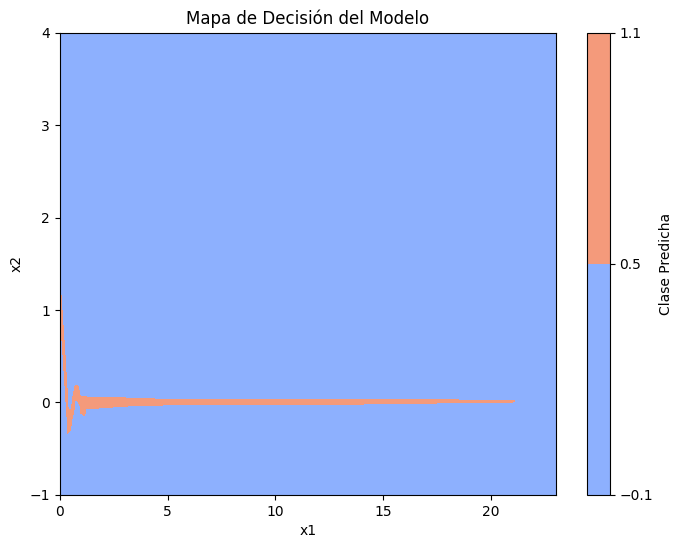

In [31]:
plt.figure(figsize=(8,6))
plt.contourf(X1, X2, preds_array, levels=[-0.1, 0.5, 1.1], cmap= 'coolwarm')
plt.colorbar(label='Clase Predicha')
plt.xlabel('x1')
plt.ylabel('x2')
plt.title('Mapa de Decisión del Modelo')
plt.show()

##### Scatter plot puntos

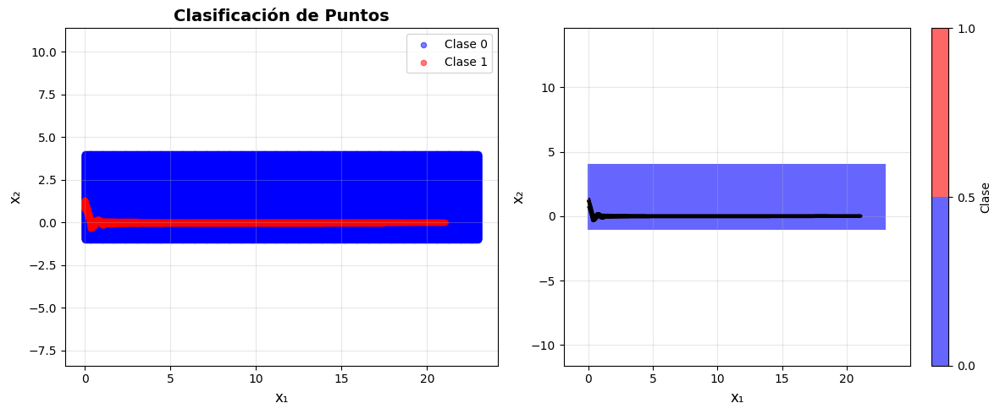

In [35]:

plt.figure(figsize=(12, 5))

plt.subplot(1, 2, 1)
plt.scatter(x1_flat[resultados == 0], x2_flat[resultados == 0], 
            c='blue', alpha=0.5, label='Clase 0', s=20)
plt.scatter(x1_flat[resultados == 1], x2_flat[resultados == 1], 
            c='red', alpha=0.5, label='Clase 1', s=20)
plt.xlabel('x₁', fontsize=12)
plt.ylabel('x₂', fontsize=12)
plt.title('Clasificación de Puntos', fontsize=14, fontweight='bold')
plt.legend()
plt.grid(True, alpha=0.3)
plt.axis('equal')

plt.subplot(1, 2, 2)
contour = plt.contourf(X1, X2, preds_array, levels=[0, 0.5, 1], colors=['blue', 'red'], alpha=0.6)
plt.contour(X1, X2, preds_array, levels=[0.5], colors='black', linewidths=3)
plt.xlabel('x₁', fontsize=12)
plt.ylabel('x₂', fontsize=12)
plt.colorbar(contour, label='Clase')
plt.grid(True, alpha=0.3)
plt.axis('equal')

plt.tight_layout()
plt.show()


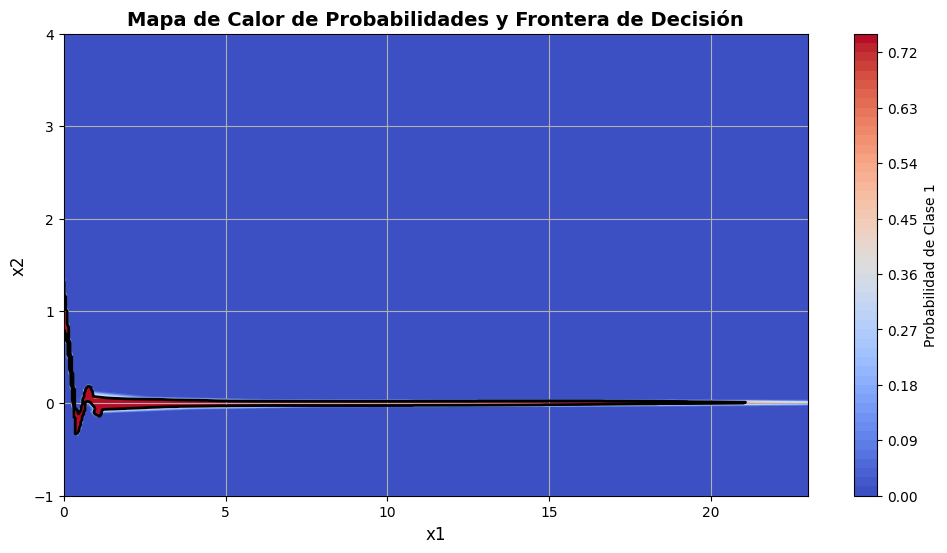

In [36]:
import numpy as np
import matplotlib.pyplot as plt

# Hacemos una función para obtener las probabilidades reales del modelo (No las discretas, redondeadas)

def predict_prob(model, x1, x2):
    # Preparamos los datos como un array (N,2)
    arr = np.array([x1, x2], dtype=np.float32).T
    #Probabiliades entre 0 y 1
    probs = model.predict(arr, verbose=0).flatten()
    return probs

# Definimos el rango de la malla 

x1_values = np.linspace(0, 23, 500)
x_2_values = np.linspace(-1, 4, 500)

x1, x2 = np.meshgrid(x1_values, x_2_values)

# Convertimos a 1D para pasarlas al modelo 
x1_flat = x1.flatten()
x2_flat = x2.flatten()

# Obtenemos las probabilidades reales del modelo

probs = predict_prob(model, x1_flat, x2_flat)

# Reconstruimos matriz con forma de malla

Z = probs.reshape(x1.shape)

# Graficamos el mapa de calor con las probabilidades reales

plt.figure(figsize=(12,6))

# Mapa de calor(probabilidad)

plt.contourf(x1, x2, Z, levels=50, cmap='coolwarm')
plt.colorbar(label='Probabilidad de Clase 1')

# Frontera de decisión (donde la probabilidad es 0.5)

plt.contour(x1, x2, Z, levels=[0.5], colors='black', linewidths=2)

plt.xlabel('x1', fontsize=12)
plt.ylabel('x2', fontsize=12)
plt.title('Mapa de Calor de Probabilidades y Frontera de Decisión', fontsize=14, fontweight='bold')

plt.grid(True)
plt.show()

Se analiza el punto de frontera como el cambio de clase es decir, cuando pasa de un estado 0 a un estado 1 comparando el actual con el siguiente

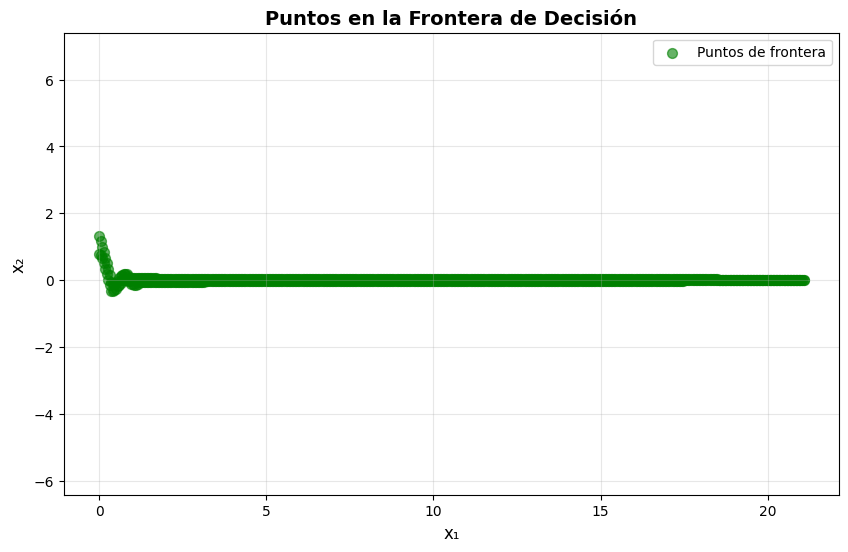

In [38]:

puntos_frontera_x1 = []
puntos_frontera_x2 = []

for i in range(len(x1_valores)):
    x1_val = x1_valores[i]
    for j in range(len(x2_valores) - 1):
        idx_actual = j * len(x1_valores) + i
        idx_siguiente = (j + 1) * len(x1_valores) + i
        
        if resultados[idx_actual] != resultados[idx_siguiente]:
            # Hay un cambio de clase aquí
            puntos_frontera_x1.append(x1_val)
            puntos_frontera_x2.append((x2_valores[j] + x2_valores[j + 1]) / 2)

puntos_frontera_x1 = np.array(puntos_frontera_x1)
puntos_frontera_x2 = np.array(puntos_frontera_x2)


# Visualizar solo la frontera
plt.figure(figsize=(10, 6))
plt.scatter(puntos_frontera_x1, puntos_frontera_x2, c='green', s=50, alpha=0.6, label='Puntos de frontera')
plt.xlabel('x₁', fontsize=12)
plt.ylabel('x₂', fontsize=12)
plt.title('Puntos en la Frontera de Decisión', fontsize=14, fontweight='bold')
plt.legend()
plt.grid(True, alpha=0.3)
plt.axis('equal')
plt.show()


### Paso 4: Graficar la funcion sobre distribucion de datos 
Se conoce que la funcion que sigue esta distribucion de datos parte de $\frac{\sin(x)}{x}$  por lo que graficaremos la funcion y variaremos sus parametros para obtener una ecuacion que se ajuste a la curva

In [46]:
mask_ones = resultados == 1.0
x_ones = x1_flat[mask_ones]
y_ones = x2_flat[mask_ones]




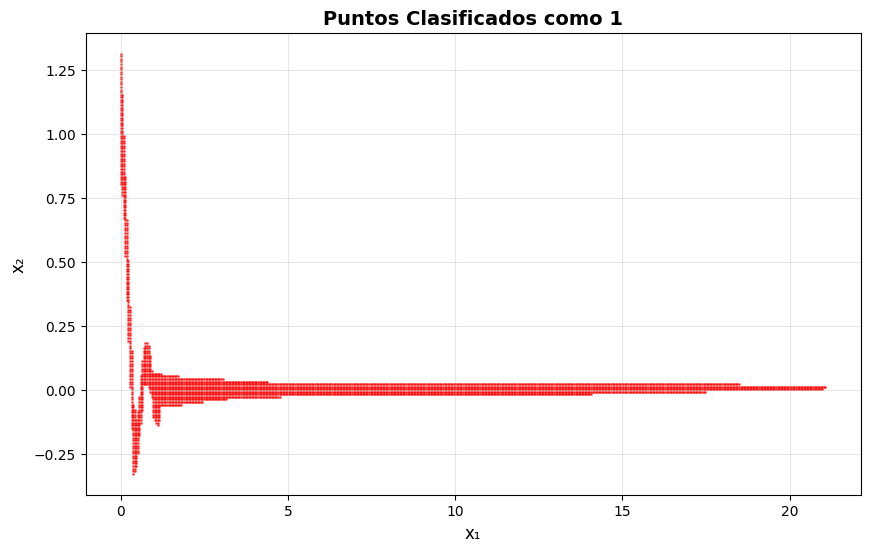

In [50]:
plt.figure(figsize=(10, 6))
plt.scatter(x_ones, y_ones, c='red', alpha=0.6, s=1)
plt.xlabel('x₁', fontsize=12)
plt.ylabel('x₂', fontsize=12)
plt.title('Puntos Clasificados como 1', fontsize=14, fontweight='bold')
plt.grid(True, alpha=0.3)
plt.show()


Reducimos la cantidad de puntos de la malla para predecir mejor la funcion 

In [54]:
x_vals = np.linspace(0.01, 15, 300)
y_vals = np.linspace(-0.5, 2.0, 300)
X, Y = np.meshgrid(x_vals, y_vals)
x1_flat, x2_flat = X.flatten(), Y.flatten()

print("Predicting batch...")
preds = predict_batch(model, X_flat.tolist(), Y_flat.tolist())
preds_array = np.array(preds).reshape(X.shape)
resultados = np.array(preds)


Predicting batch...
2813/2813 ━━━━━━━━━━━━━━━━━━━━ 8s 3ms/step


In [55]:
mask_ones = resultados == 1.0
x_ones = x1_flat[mask_ones]
y_ones = x2_flat[mask_ones]



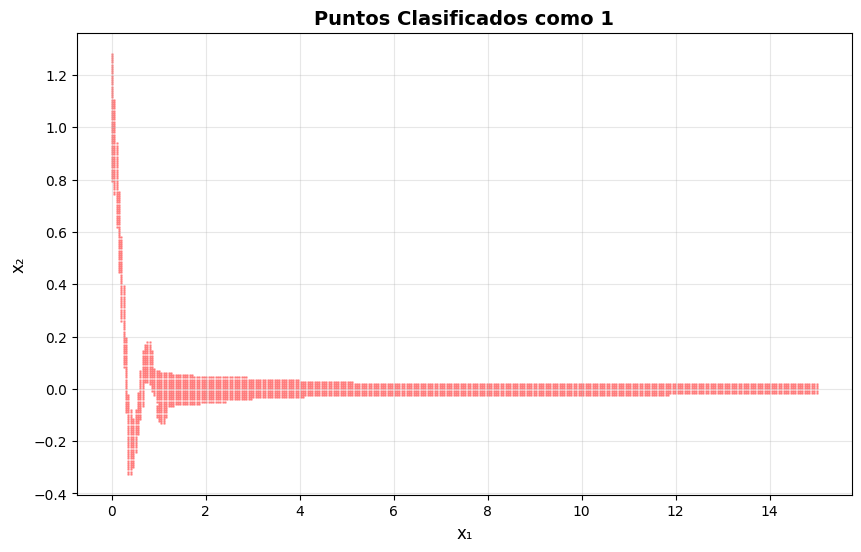

In [57]:
plt.figure(figsize=(10, 6))
plt.scatter(x_ones, y_ones, c='red', alpha=0.3, s=1)
plt.xlabel('x₁', fontsize=12)
plt.ylabel('x₂', fontsize=12)
plt.title('Puntos Clasificados como 1', fontsize=14, fontweight='bold')
plt.grid(True, alpha=0.3)
plt.show()


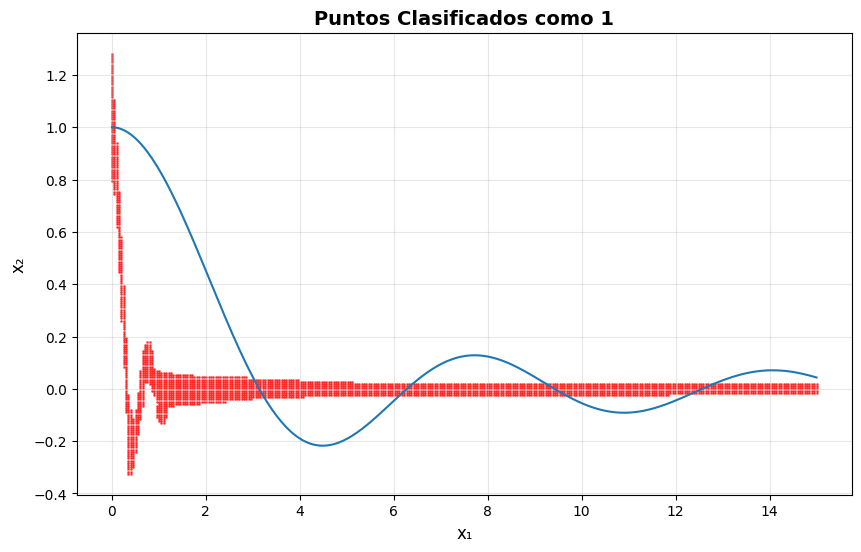

In [59]:
plt.figure(figsize=(10, 6))
plt.scatter(x_ones, y_ones, c='red', alpha=0.6, s=1)
plt.plot(x_vals, np.sin(x_vals) / x_vals)
plt.xlabel('x₁', fontsize=12)
plt.ylabel('x₂', fontsize=12)
plt.title('Puntos Clasificados como 1', fontsize=14, fontweight='bold')
plt.grid(True, alpha=0.3)
plt.show()


Variamos los parametros manualmente para encontrar la funcion que mejor se aproxime 

Usamos la ecuacion $\frac{\sin(8x)}{x}$

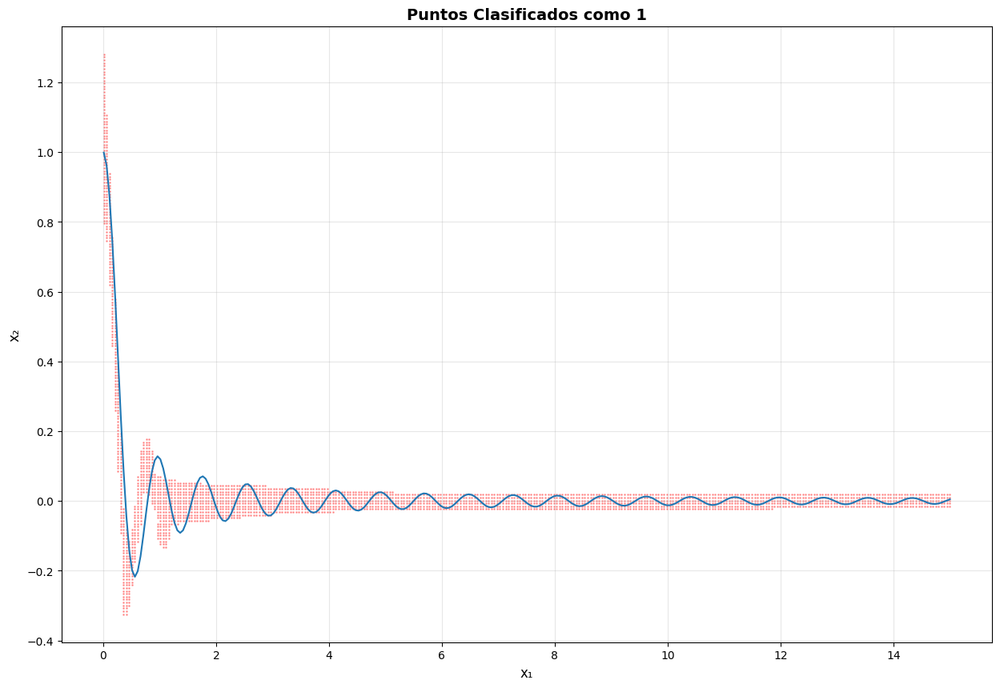

In [67]:
plt.figure(figsize=(15, 10))
plt.scatter(x_ones, y_ones, c='red', alpha=0.3, s=1)
plt.plot(x_vals, np.sin(8*x_vals) / (8*x_vals))
plt.xlabel('x₁', fontsize=12)
plt.ylabel('x₂', fontsize=12)
plt.title('Puntos Clasificados como 1', fontsize=14, fontweight='bold')
plt.grid(True, alpha=0.3)
plt.show()


Variamos la ecuacion a $\frac{\sin(8x)}{x}$

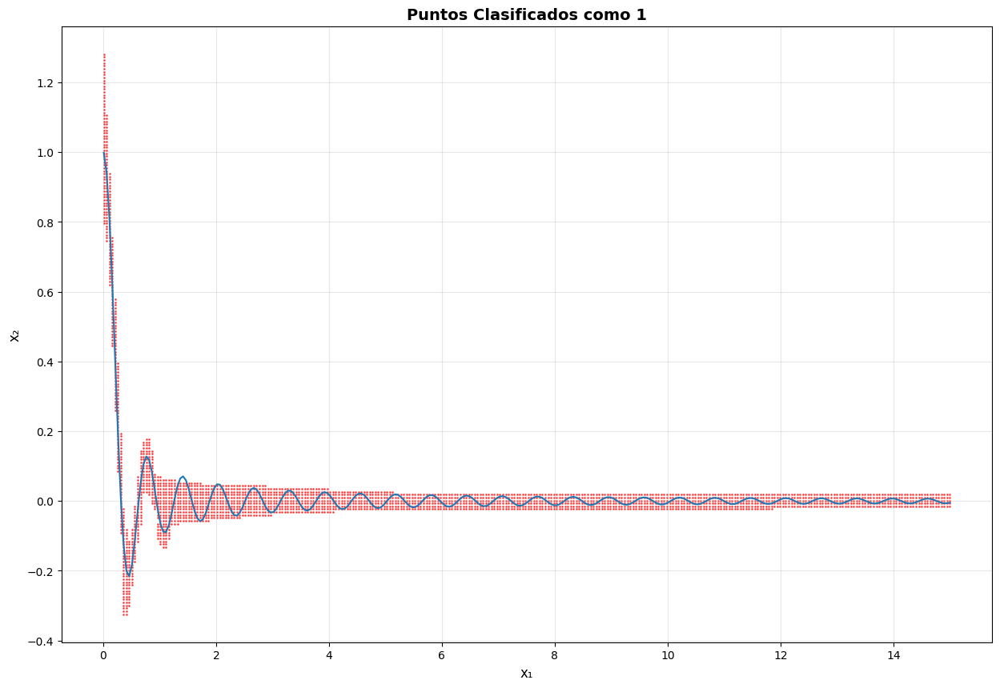

In [66]:
plt.figure(figsize=(15, 10))
plt.scatter(x_ones, y_ones, c='red', alpha=0.6, s=1)
plt.plot(x_vals, np.sin(10*x_vals) / (10*x_vals))
plt.xlabel('x₁', fontsize=12)
plt.ylabel('x₂', fontsize=12)
plt.title('Puntos Clasificados como 1', fontsize=14, fontweight='bold')
plt.grid(True, alpha=0.3)
plt.show()


### Paso 5: Ajustar los parametros de la funcion 


### Ajuste de Parámetros mediante Mínimos Cuadrados No Lineales

Para aproximar la relación analítica entre $x_1$ y $x_2$, se define la función base $\frac{\sin(x)}{x}$ (función sinc) y se propone la ecuación paramétrica:

$$y = a \cdot \frac{\sin(b \cdot x)}{b \cdot x} + c$$

donde $a, b, c \in \mathbb{R}$ son los parámetros a determinar.

Para encontrar los valores óptimos de estos parámetros, se utiliza la función `curve_fit` de `scipy.optimize`, que por defecto implementa el algoritmo **Levenberg-Marquardt (LM)**.

#### El Método Levenberg-Marquardt: Fundamentos Matemáticos

El método de Levenberg-Marquardt es un algoritmo híbrido que combina el método de Gauss-Newton y el método de descenso de gradiente, diseñado específicamente para resolver problemas de mínimos cuadrados no lineales.

**Formulación del Problema:**

Dado un conjunto de $n$ puntos observados $(x_i, y_i)$ para $i = 1, 2, \ldots, n$, buscamos minimizar la suma de los cuadrados de los residuos:

$$S(\boldsymbol{\theta}) = \sum_{i=1}^{n} [y_i - f(x_i, \boldsymbol{\theta})]^2 = \sum_{i=1}^{n} r_i^2(\boldsymbol{\theta})$$

donde:
- $f(x_i, \boldsymbol{\theta})$ es el modelo paramétrico (en nuestro caso: $f(x, a, b, c) = a \cdot \frac{\sin(bx)}{bx} + c$)
- $\boldsymbol{\theta} = [a, b, c]^T$ es el vector de parámetros a estimar
- $r_i(\boldsymbol{\theta}) = y_i - f(x_i, \boldsymbol{\theta})$ es el residuo del $i$-ésimo punto

**Cálculo del Error (Función Objetivo):**

El error total se cuantifica mediante la **Suma de Cuadrados de Residuos (SSR)**:

$$SSR = \sum_{i=1}^{n} r_i^2 = \sum_{i=1}^{n} [y_i - f(x_i, \boldsymbol{\theta})]^2$$

Alternativamente, se puede usar el **Error Cuadrático Medio (RMSE)**:

$$RMSE = \sqrt{\frac{1}{n} \sum_{i=1}^{n} [y_i - f(x_i, \boldsymbol{\theta})]^2} = \sqrt{\frac{SSR}{n}}$$

**El Algoritmo Iterativo:**

El método LM actualiza iterativamente el vector de parámetros mediante:

$$\boldsymbol{\theta}^{(k+1)} = \boldsymbol{\theta}^{(k)} - \left[\mathbf{J}^T \mathbf{J} + \lambda^{(k)} \mathbf{I}\right]^{-1} \mathbf{J}^T \mathbf{r}$$

donde:
- $\boldsymbol{\theta}^{(k)}$ es el vector de parámetros en la iteración $k$
- $\mathbf{J}$ es la **matriz Jacobiana** de dimensiones $n \times p$ (donde $p$ es el número de parámetros), cuyos elementos son:

$$J_{ij} = \frac{\partial r_i}{\partial \theta_j} = -\frac{\partial f(x_i, \boldsymbol{\theta})}{\partial \theta_j}$$

Para nuestro modelo $f(x, a, b, c) = a \cdot \frac{\sin(bx)}{bx} + c$, las derivadas parciales son:

$$\frac{\partial f}{\partial a} = \frac{\sin(bx)}{bx}$$

$$\frac{\partial f}{\partial b} = a \cdot \frac{x \cos(bx) - \sin(bx)}{b^2 x}$$

$$\frac{\partial f}{\partial c} = 1$$

- $\mathbf{r} = [r_1, r_2, \ldots, r_n]^T$ es el vector de residuos
- $\lambda^{(k)}$ es el **parámetro de regularización** (o parámetro de amortiguamiento) en la iteración $k$
- $\mathbf{I}$ es la matriz identidad

**Estrategia de Adaptación del Parámetro $\lambda$:**

El parámetro $\lambda$ controla el comportamiento del algoritmo:
- Si $\lambda \to 0$: El método se comporta como **Gauss-Newton** (rápido cerca del mínimo)
- Si $\lambda \to \infty$: El método se comporta como **descenso de gradiente** (más robusto pero más lento)

La estrategia adaptativa es:
1. Si $S(\boldsymbol{\theta}^{(k+1)}) < S(\boldsymbol{\theta}^{(k)})$: Se acepta el nuevo parámetro y se **reduce** $\lambda$ (por ejemplo, $\lambda^{(k+1)} = \lambda^{(k)} / 10$)
2. Si $S(\boldsymbol{\theta}^{(k+1)}) \geq S(\boldsymbol{\theta}^{(k)})$: Se **rechaza** el nuevo parámetro, se **aumenta** $\lambda$ (por ejemplo, $\lambda^{(k+1)} = 10 \cdot \lambda^{(k)}$) y se repite el cálculo

**Criterios de Convergencia:**

El algoritmo termina cuando se cumple alguno de los siguientes criterios:
1. **Convergencia en parámetros**: $\|\boldsymbol{\theta}^{(k+1)} - \boldsymbol{\theta}^{(k)}\| < \epsilon_{\theta}$
2. **Convergencia en función objetivo**: $|S(\boldsymbol{\theta}^{(k+1)}) - S(\boldsymbol{\theta}^{(k)})| < \epsilon_S$
3. **Convergencia en gradiente**: $\|\nabla S(\boldsymbol{\theta}^{(k)})\| < \epsilon_g$
4. **Número máximo de iteraciones**: $k > k_{max}$

**Ventajas del Método LM:**

- **Robustez**: Combina la velocidad de Gauss-Newton con la estabilidad del descenso de gradiente
- **Eficiencia**: Converge rápidamente cuando está cerca del mínimo
- **Adaptabilidad**: El parámetro $\lambda$ se ajusta automáticamente durante las iteraciones
- **Aplicabilidad**: Funciona bien para problemas de ajuste de curvas con modelos no lineales

**Limitaciones:**

- Requiere una buena estimación inicial de los parámetros
- Puede converger a mínimos locales si la función objetivo tiene múltiples mínimos
- El cálculo de la matriz Jacobiana puede ser costoso computacionalmente para modelos complejos

#### Implementación del Ajuste de Curvas

Ahora implementaremos el método de Levenberg-Marquardt usando `curve_fit` de scipy para encontrar los parámetros óptimos $a$, $b$ y $c$ de la función:

$$y = a \cdot \frac{\sin(b \cdot x)}{b \cdot x} + c$$

**Pasos a seguir:**
1. Preparar los datos: extraer los puntos de la frontera de decisión
2. Definir la función modelo con parámetros
3. Aplicar `curve_fit` con valores iniciales razonables
4. Visualizar los resultados del ajuste


##### Paso 5.1: Preparar los datos para el ajuste

Necesitamos extraer los puntos de la frontera de decisión. Usaremos los puntos donde el modelo clasifica como 1, y específicamente nos enfocaremos en los puntos del borde superior de la región clasificada como 1.


In [68]:
# Extraer puntos clasificados como 1
mask_ones = resultados == 1.0
x_ones = x1_flat[mask_ones]
y_ones = x2_flat[mask_ones]

print(f"Total de puntos clasificados como 1: {len(x_ones)}")

# Para el ajuste, necesitamos encontrar el borde superior
# Agrupamos por valores de x1 y tomamos el máximo y2 para cada x1
from collections import defaultdict

# Agrupar por x1 (redondeado para agrupar valores cercanos)
x1_groups = defaultdict(list)
for i in range(len(x_ones)):
    x1_key = round(x_ones[i], 2)  # Redondeamos a 2 decimales para agrupar
    x1_groups[x1_key].append((x_ones[i], y_ones[i]))

# Para cada grupo, tomar el punto con mayor y2 (borde superior)
x_fit = []
y_fit = []

for x1_key in sorted(x1_groups.keys()):
    group = x1_groups[x1_key]
    # Encontrar el punto con mayor y2 en este grupo
    max_y = max(group, key=lambda p: p[1])
    x_fit.append(max_y[0])
    y_fit.append(max_y[1])

x_fit = np.array(x_fit)
y_fit = np.array(y_fit)

print(f"Puntos del borde superior para ajuste: {len(x_fit)}")
print(f"Rango de x1: [{x_fit.min():.2f}, {x_fit.max():.2f}]")
print(f"Rango de y2: [{y_fit.min():.2f}, {y_fit.max():.2f}]")


Total de puntos clasificados como 1: 2585
Puntos del borde superior para ajuste: 300
Rango de x1: [0.01, 15.00]
Rango de y2: [-0.12, 1.28]


##### Paso 5.2: Definir la función modelo

Definimos la función sinc parametrizada que queremos ajustar a los datos.


In [87]:
def sinc_func(x, a, b, c):
    """
    Función sinc parametrizada: y = a * sin(b*x) / (b*x) + c
    
    Parámetros:
    - x: variable independiente
    - a: amplitud
    - b: frecuencia
    - c: desplazamiento vertical
    
    Retorna:
    - y: valor de la función
    """
    # Evitar división por cero cuando b*x es muy pequeño
    bx = b * x
    epsilon = 1e-9
    return a * np.sin(bx) / (bx + epsilon) + c


##### Paso 5.3: Implementar el ajuste

Usaremos `leastsq` que es lo que `curve_fit` usa internamente. La diferencia es:

- **curve_fit**: `curve_fit(sinc_func, x_fit, y_fit, p0=[...])` - pasa función y datos
- **leastsq**: `leastsq(residual_func, p0)` - pasa función de residuos (los datos van dentro)

Ambos hacen lo mismo, pero `leastsq` nos permite ver las iteraciones.


**Nota importante:** 

En `curve_fit` se pasan los datos así:
```python
curve_fit(sinc_func, x_fit, y_fit, p0=[1.2, 8.5, 0.03])
```

En `leastsq` los datos `x_fit` y `y_fit` están dentro de la función `residual_func`. 
La función `residual_func` usa `x_fit` y `y_fit` que ya están definidos en celdas anteriores.


In [89]:
from scipy.optimize import curve_fit

p0_curve = [1.2, 8.5, 0]
popt_curve, _ = curve_fit(sinc_func, x_fit, y_fit, p0=p0_curve, maxfev=1000)

print(f"Parámetros con curve_fit: a={popt_curve[0]}, b={popt_curve[1]}, c={popt_curve[2]}")


Parámetros con curve_fit: a=1.1196231395609308, b=9.696037359693293, c=0.029507155666119826


In [96]:
from scipy.optimize import leastsq

# Lista para guardar las iteraciones
iteraciones = []
ultimos_params = None

def residual_func(params):
    """
    Función de residuos para leastsq
    
    Esta función recibe los parámetros [a, b, c] y devuelve los residuos.
    Los datos x_fit y y_fit se usan dentro de esta función.
    
    """
    global ultimos_params
    
    a, b, c = params
    # Calcular predicciones usando la función modelo
    y_pred = sinc_func(x_fit, a, b, c)
    # Calcular residuos (diferencia entre observado y predicho)
    residuos = y_fit - y_pred
    
    # Guardar iteración si los parámetros cambiaron
    if ultimos_params is None or not np.allclose(params, ultimos_params, rtol=1e-6):
        ultimos_params = params.copy()
        ssr = np.sum(residuos**2)
        rmse = np.sqrt(np.mean(residuos**2))
        iteraciones.append({
            'iteracion': len(iteraciones) + 1,
            'a': a,
            'b': b,
            'c': c,
            'ssr': ssr,
            'rmse': rmse
        })
        print(f"Iteración {len(iteraciones):3d}: a={a:8.4f}, b={b:8.4f}, c={c:8.4f}, SSR={ssr:.6f}, RMSE={rmse:.6f}")
    
    return residuos

# Valores iniciales
p0 = [1, 1, 0]


print(f"Valores iniciales: a={p0[0]}, b={p0[1]}, c={p0[2]}")
print()


popt, _ = leastsq(residual_func, p0, maxfev=1000)


print(f"Parámetros finales: a={popt[0]:.6f}, b={popt[1]:.6f}, c={popt[2]:.6f}")


Valores iniciales: a=1, b=1, c=0

Iteración   1: a=  1.0000, b=  1.0000, c=  0.0000, SSR=22.968802, RMSE=0.276700
Iteración   2: a=  1.0000, b=  1.0000, c=  0.0000, SSR=22.968803, RMSE=0.276700
Iteración   3: a=  0.1961, b=  1.0120, c=  0.0221, SSR=3.666935, RMSE=0.110558
Iteración   4: a=  0.1979, b=  1.0747, c=  0.0222, SSR=3.626022, RMSE=0.109940
Iteración   5: a=  0.2061, b=  1.1403, c=  0.0232, SSR=3.583839, RMSE=0.109298
Iteración   6: a=  0.2143, b=  1.2085, c=  0.0245, SSR=3.540086, RMSE=0.108629
Iteración   7: a=  0.2241, b=  1.2824, c=  0.0251, SSR=3.492426, RMSE=0.107895
Iteración   8: a=  0.2349, b=  1.3510, c=  0.0246, SSR=3.450711, RMSE=0.107249
Iteración   9: a=  0.2448, b=  1.4171, c=  0.0239, SSR=3.411047, RMSE=0.106631
Iteración  10: a=  0.2548, b=  1.4895, c=  0.0238, SSR=3.364840, RMSE=0.105906
Iteración  11: a=  0.2647, b=  1.5643, c=  0.0245, SSR=3.316640, RMSE=0.105145
Iteración  12: a=  0.2743, b=  1.6408, c=  0.0254, SSR=3.267960, RMSE=0.104370
Iteración  13: a

##### Paso 5.4: Mostrar todas las iteraciones

Mostramos todas las iteraciones guardadas durante el proceso de optimización.


In [97]:
print("Iteraciones del algoritmo:")
print()
for it in iteraciones:
    print(f"Iteración {it['iteracion']:3d}: a={it['a']:8.4f}, b={it['b']:8.4f}, c={it['c']:8.4f}, SSR={it['ssr']:.6f}, RMSE={it['rmse']:.6f}")

print()
print(f"Total de iteraciones: {len(iteraciones)}")


Iteraciones del algoritmo:

Iteración   1: a=  1.0000, b=  1.0000, c=  0.0000, SSR=22.968802, RMSE=0.276700
Iteración   2: a=  1.0000, b=  1.0000, c=  0.0000, SSR=22.968803, RMSE=0.276700
Iteración   3: a=  0.1961, b=  1.0120, c=  0.0221, SSR=3.666935, RMSE=0.110558
Iteración   4: a=  0.1979, b=  1.0747, c=  0.0222, SSR=3.626022, RMSE=0.109940
Iteración   5: a=  0.2061, b=  1.1403, c=  0.0232, SSR=3.583839, RMSE=0.109298
Iteración   6: a=  0.2143, b=  1.2085, c=  0.0245, SSR=3.540086, RMSE=0.108629
Iteración   7: a=  0.2241, b=  1.2824, c=  0.0251, SSR=3.492426, RMSE=0.107895
Iteración   8: a=  0.2349, b=  1.3510, c=  0.0246, SSR=3.450711, RMSE=0.107249
Iteración   9: a=  0.2448, b=  1.4171, c=  0.0239, SSR=3.411047, RMSE=0.106631
Iteración  10: a=  0.2548, b=  1.4895, c=  0.0238, SSR=3.364840, RMSE=0.105906
Iteración  11: a=  0.2647, b=  1.5643, c=  0.0245, SSR=3.316640, RMSE=0.105145
Iteración  12: a=  0.2743, b=  1.6408, c=  0.0254, SSR=3.267960, RMSE=0.104370
Iteración  13: a=  0.2

##### Paso 5.5: Métricas de error finales

Calculamos las métricas finales del ajuste.


In [98]:
# Calcular errores finales
y_pred = sinc_func(x_fit, *popt)
ssr = np.sum((y_fit - y_pred)**2)
rmse = np.sqrt(np.mean((y_fit - y_pred)**2))

print("Métricas finales:")
print(f"SSR = {ssr}")
print(f"RMSE = {rmse}")


Métricas finales:
SSR = 0.30144381498303807
RMSE = 0.031698780995649135


##### Paso 5.6: Visualización de resultados

Ahora visualizamos los datos originales junto con la curva ajustada.


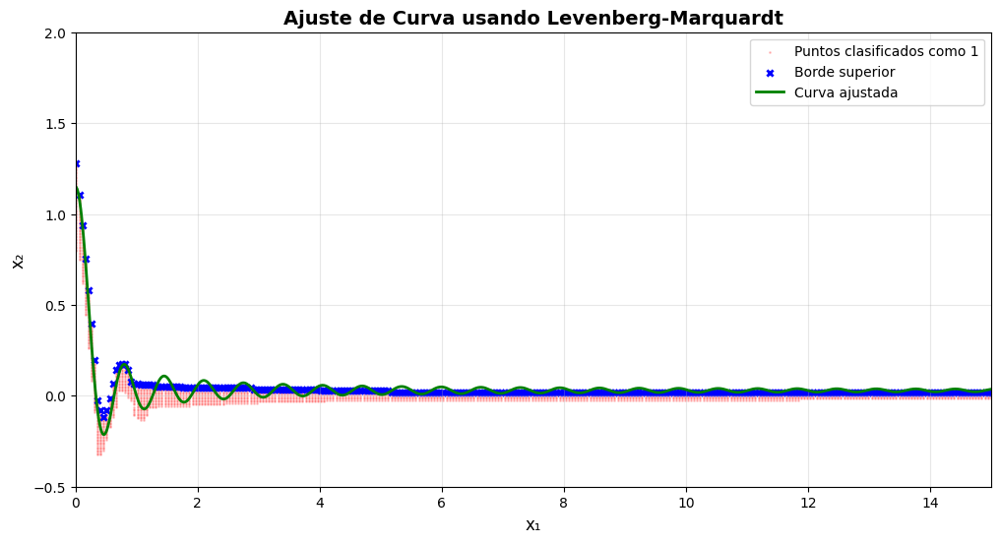

Ecuación final:
y = 1.119623 · sin(9.696030·x) / (9.696030·x) + 0.029507


In [99]:
# Crear puntos suaves para la curva ajustada
x_smooth = np.linspace(x_fit.min(), x_fit.max(), 1000)
y_smooth = sinc_func(x_smooth, *popt)

# Graficar
plt.figure(figsize=(12, 6))

# Puntos originales
plt.scatter(x_ones, y_ones, c='red', alpha=0.2, s=1, label='Puntos clasificados como 1')

# Puntos del borde usado para el ajuste
plt.scatter(x_fit, y_fit, c='blue', s=20, marker='x', linewidths=2, label='Borde superior')

# Curva ajustada
plt.plot(x_smooth, y_smooth, 'g-', linewidth=2, label='Curva ajustada')

plt.xlabel('x₁', fontsize=12)
plt.ylabel('x₂', fontsize=12)
plt.title('Ajuste de Curva usando Levenberg-Marquardt', fontsize=14, fontweight='bold')
plt.legend()
plt.grid(True, alpha=0.3)
plt.xlim(0, 15)
plt.ylim(-0.5, 2.0)
plt.show()

print("Ecuación final:")
print(f"y = {popt[0]:.6f} · sin({popt[1]:.6f}·x) / ({popt[1]:.6f}·x) + {popt[2]:.6f}")


Iteración   1: a=  1.0000, b=  1.0000, c=  0.0000, SSR=22.968802, RMSE=0.276700
Iteración   1: a=  1.0000, b=  1.0000, c=  0.0000, SSR=22.968802, RMSE=0.276700
[11-24 14:09:59][INFO] Animation.save using <class 'matplotlib.animation.HTMLWriter'>


Iteración   1: a=  1.0000, b=  1.0000, c=  0.0000, SSR=22.968802, RMSE=0.276700
Iteración   1: a=  1.0000, b=  1.0000, c=  0.0000, SSR=22.968802, RMSE=0.276700
Iteración   2: a=  1.0000, b=  1.0000, c=  0.0000, SSR=22.968803, RMSE=0.276700
Iteración   3: a=  0.1961, b=  1.0120, c=  0.0221, SSR=3.666935, RMSE=0.110558
Iteración   4: a=  0.1979, b=  1.0747, c=  0.0222, SSR=3.626022, RMSE=0.109940
Iteración   5: a=  0.2061, b=  1.1403, c=  0.0232, SSR=3.583839, RMSE=0.109298
Iteración   6: a=  0.2143, b=  1.2085, c=  0.0245, SSR=3.540086, RMSE=0.108629
Iteración   7: a=  0.2241, b=  1.2824, c=  0.0251, SSR=3.492426, RMSE=0.107895
Iteración   8: a=  0.2349, b=  1.3510, c=  0.0246, SSR=3.450711, RMSE=0.107249
Iteración   9: a=  0.2448, b=  1.4171, c=  0.0239, SSR=3.411047, RMSE=0.106631
Iteración  10: a=  0.2548, b=  1.4895, c=  0.0238, SSR=3.364840, RMSE=0.105906
Iteración  11: a=  0.2647, b=  1.5643, c=  0.0245, SSR=3.316640, RMSE=0.105145
Iteración  12: a=  0.2743, b=  1.6408, c=  0.0254

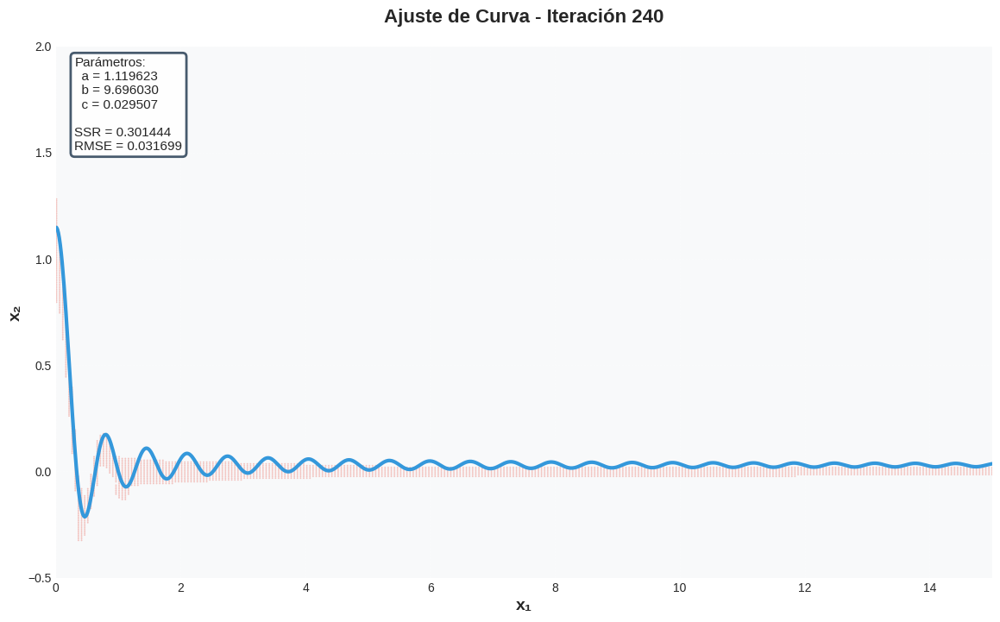

In [102]:
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
import matplotlib.patches as mpatches

x_smooth = np.linspace(0.01, 15, 1000)

plt.style.use('seaborn-v0_8-darkgrid')
fig, ax = plt.subplots(figsize=(14, 8))
fig.patch.set_facecolor('white')
ax.set_facecolor('#f8f9fa')

ax.scatter(x_ones, y_ones, c='#e74c3c', alpha=0.3, s=2, edgecolors='none')
line, = ax.plot([], [], '#3498db', linewidth=3, label='Curva ajustada')
ax.set_xlim(0, 15)
ax.set_ylim(-0.5, 2.0)
ax.set_xlabel('x₁', fontsize=14, fontweight='bold')
ax.set_ylabel('x₂', fontsize=14, fontweight='bold')
ax.set_title('Ajuste de Curva - Iteración 0', fontsize=16, fontweight='bold', pad=20)
ax.grid(True, alpha=0.3, linestyle='--', linewidth=0.5)

info_text = ax.text(0.02, 0.98, '', transform=ax.transAxes, fontsize=11,
                    verticalalignment='top', bbox=dict(boxstyle='round', 
                    facecolor='white', alpha=0.9, edgecolor='#34495e', linewidth=2))

def animate(frame):
    if frame < len(iteraciones):
        it = iteraciones[frame]
        y_smooth = sinc_func(x_smooth, it['a'], it['b'], it['c'])
        line.set_data(x_smooth, y_smooth)
        ax.set_title(f'Ajuste de Curva - Iteración {it["iteracion"]}', 
                     fontsize=16, fontweight='bold', pad=20)
        
        info = f'Parámetros:\n  a = {it["a"]:.6f}\n  b = {it["b"]:.6f}\n  c = {it["c"]:.6f}\n\n'
        info += f'SSR = {it["ssr"]:.6f}\nRMSE = {it["rmse"]:.6f}'
        info_text.set_text(info)
        
        print(f'Iteración {it["iteracion"]:3d}: a={it["a"]:8.4f}, b={it["b"]:8.4f}, c={it["c"]:8.4f}, SSR={it["ssr"]:.6f}, RMSE={it["rmse"]:.6f}')
    
    return line, info_text

ani = FuncAnimation(fig, animate, frames=len(iteraciones), interval=200, repeat=True, blit=True)
HTML(ani.to_jshtml())
